<a href="https://colab.research.google.com/github/Sithlord-dev/Dog_vision/blob/main/Dog_bread_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


![separator](img/sep.jpeg)
# Dog bread classification using convolutional neural networks 🐕 

![separator](img/sep.jpeg)

In this project we use Deep Learning, and particularily convolutional neural networks to build a model that will help us identify up to 120 different breeds of dogs 🐩

In this multi-class image classification task, we will use [Kaggle dog breed identification competition](https://www.kaggle.com/c/dog-breed-identification/overview). which consists of a collection of 10,000+ labelled images of 120 different dog breeds.

## 🦮 Task description: 

In image classification problems, convolutional neural networks (CNN for short) are somehow one of the most popular and effective neural network models to consider, especially if it's combined with Data augumentation. My first attempt was to build a CNN with the following configuration:
```
Layer (type)                 Output Shape              Param #   
=================================================================
conv2d_9 (Conv2D)            (None, 126, 126, 32)      896       
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 63, 63, 32)        0         
_________________________________________________________________
dropout_3 (Dropout)          (None, 63, 63, 32)        0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 61, 61, 32)        9248      
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 30, 30, 32)        0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 30, 30, 32)        0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 28, 28, 64)        18496     
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 14, 14, 64)        0         
_________________________________________________________________
dropout_5 (Dropout)          (None, 14, 14, 64)        0         
_________________________________________________________________
flatten_3 (Flatten)          (None, 12544)             0         
_________________________________________________________________
dense_6 (Dense)              (None, 128)               1605760   
_________________________________________________________________
dense_7 (Dense)              (None, 64)                8256      
_________________________________________________________________
dropout_6 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_8 (Dense)              (None, 120)               7800      
=================================================================
Total params: 1,650,456
Trainable params: 1,650,456
Non-trainable params: 0
```
Alas, as hard as I went tunning and tweaking, I could not reach a higher accuracy than 2x%... I then though of using transfer learning: Imagenet is known for providing a quite good dog and birds breeds training data set, and one can use a pre-trained model on that to get aime for better results. We will use 


Here is a short summary of what we will be doing:

* **Data analysis** - We prepare, study and explore a dataset, highliting important correlations.
* **Model modelling** - we create and train a model to predict a target variable, then we tune the hyper-parameters of our model in order to improve it if possible.
* **Model evaluation and comparison** - we evaluate it using some metrics and compare them to find the best one.  
* **Model experimentation** - we try to improve the model through experimentation by starting with 1000 images, make sure it works, increase the number of images.
* **Conclusion**.

To work through these topics, we'll use `pandas`, `Matplotlib` and `NumPy` for data anaylsis, as well as, `TensorFlow Hub`, `tf.keras.applications`, `TensorBoard` and `EarlyStopping` for machine learning and modelling tasks:

In [ ]:
# Data analysis libraries
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import linregress, norm

## Tensorflow:
import tensorflow as tf
import tensorflow_hub as hub

## keras model layers and callback:
import keras
from keras import models
from keras.models import Sequential, model_from_json
from keras.layers import Conv2D, MaxPooling2D, Dense, Flatten, Dropout, GlobalAveragePooling2D, BatchNormalization, InputLayer, Lambda, Input
from keras.callbacks import TensorBoard, ModelCheckpoint
from keras.optimizers import Adam, SGD, RMSprop
from keras.models import Model, Input

## Keras models
from keras import applications
from keras.applications.inception_v3 import InceptionV3
from keras.applications.nasnet import NASNetLarge
from keras.applications.inception_resnet_v2 import InceptionResNetV2
from keras.applications.xception import Xception

## Scikit Learn Model evaluators:
from sklearn.model_selection import train_test_split, cross_val_score, KFold
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn import metrics
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import precision_score, recall_score, f1_score

## Loading images
from IPython.display import display, Image
import os
from urllib import request
from io import BytesIO

## Preprocessing:
from keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array

## Check for GPU
print("GPU", "available" if tf.config.list_physical_devices("GPU") else "not available...")

GPU not available...


For visibility reasons, I will use the following set of colours : 
<span style='color:#e34933'>#e34933</span>, <span style='color:#feca79'>#feca79</span>, <span style='color:#e3f399'>#e3f399</span>, <span style='color:#6ec064'>#6ec064</span> and <span style='color:#006837'>#006837</span>

Here are some useful functions that we will be using all along:

In [ ]:
#sns.heatmap(np.linspace(1,5,15).reshape(5,3), cmap='RdYlGn');
colours = [ '#e34933', '#feca79', '#e3f399', '#6ec064', '#006837']

In [ ]:
def save_model(model, suffix=None):
    '''
    Saves a given model in a models directory and appends a suffix (str)
    for clarity and reuse.
    '''
    # Create model directory with current time
    model_dir = os.path.join('/content/drive/MyDrive/ML/dog_breed/models',
                          datetime.datetime.now().strftime('%d-%m-%Y - %H:%M:%S'))
    model_path = model_dir + "-" + suffix + ".h5" # save format of model
    print('Saving model to: {}...'.format(model_path))
    model.save(model_path)
    return model_path

def load_model(model_path):
    '''
    Loads a saved model (from Tensorflow Hub)
    '''
    print('Loading saved model from: {}'.format(model_path))
    model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
    return model

def conf_mtrx_plot(mtrx, i = None) :
    '''
    Plots the first ixi shape of the confusion matrix 
    '''
    fig, ax = plt.subplots(figsize = (16,16))

    ax = sns.heatmap(data = mtrx[:i, :i],
                     cmap = 'RdYlGn',
                     #fmt = '.2f',
                     robust = True,
                     center = 0,
                     square = True,
                     annot = True,
                     xticklabels = breeds[:i],
                     yticklabels = breeds[:i])
    plt.ylabel('True')
    plt.xlabel('Predicted')
    plt.show()

def get_model_name(k):
    return 'model_'+str(k)+'fold.h5'

![separator](img/sep.jpeg)
## 1) Data analysis: 🌭


The original is from the [Kaggle dog breed identification competition](https://www.kaggle.com/c/dog-breed-identification/overview) which consists of a collection of more than 10k labelled images of 120 different dog breeds.

### 🐶 Data description: 

We start by reading our CSV file using `pandas` :

In [ ]:
train_df = pd.read_csv("drive/MyDrive/ML/dog_breed/files/labels.csv")
train_df.describe()

,id,breed
count,10222,10222
unique,10222,120
top,3a1eeae505c9fedcfd97d3eaa94c3c66,scottish_deerhound
freq,1,126


We have in total 10.222 images `id`s with a total of 120 `breed`

In [ ]:
train_df.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


The rows in the dataset represent image ids for each dog breed. We check how these **labels** are distributed:

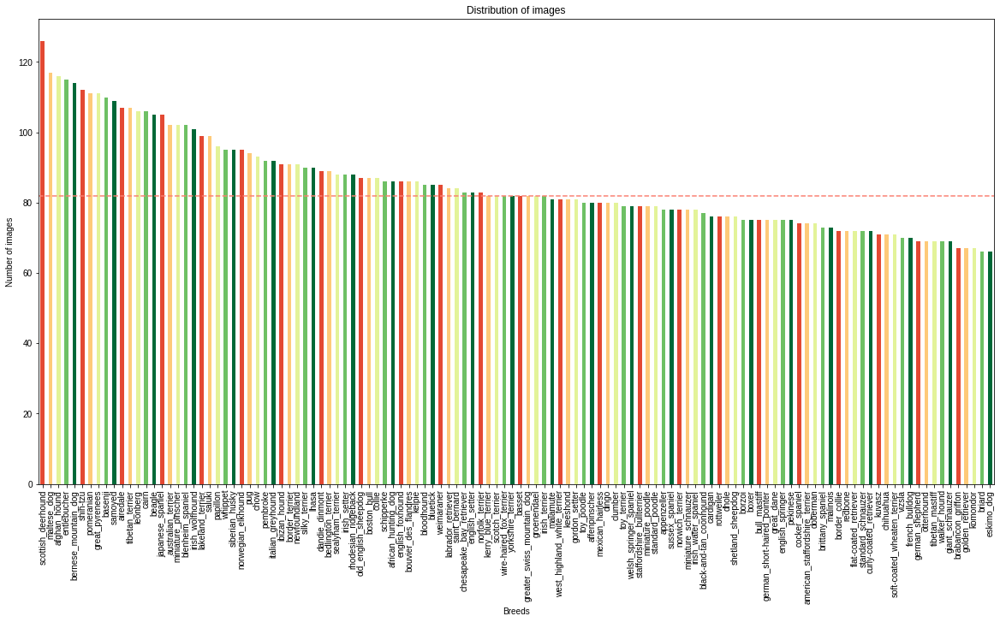

In [ ]:
fig, ax = plt.subplots(figsize = (20,10))

train_df['breed'].value_counts().plot(kind = 'bar',
                                  color=colours,
                                  ax = ax)
# average line
ax.axhline(train_df['breed'].value_counts().median(), ls = '--', c = 'salmon')

# plot info
plt.style.use('seaborn-whitegrid')
plt.title('Distribution of images')
plt.xlabel('Breeds')
plt.ylabel('Number of images');

with an average of 82 picture per breed:

In [ ]:
train_df['breed'].value_counts().median()

82.0

We will create a list of filepaths to images instead of importing them all and use `IPython.display` to view them:

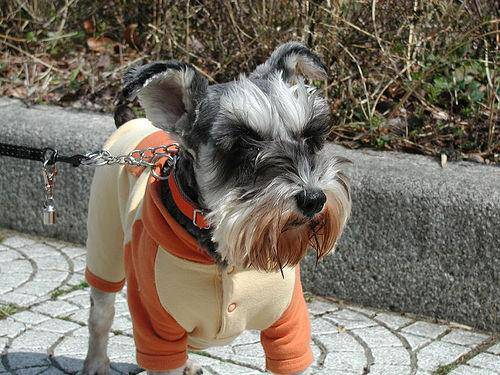

In [ ]:
train_dir = "drive/MyDrive/ML/dog_breed/files/train/"
test_dir = "drive/MyDrive/ML/dog_breed/files/test/"

# Create pathnames from image ID's
img_name = [train_dir + fname + ".jpg" for fname in train_df["id"]]

#show a random image:
Image(img_name[np.random.randint(1,10000)])

### 🐶 Set up:

We first encode our labels into a boolean format:

In [ ]:
labels = np.array(train_df['breed'])
breeds = np.unique(labels)

enc_labels = [ label == np.array(breeds) for label in labels ]

and we use Scikit Learn's `train_test_split` to create a validation set:

In [ ]:
# dataset variables
X = img_name
y = enc_labels

# set a size parameter
SUBSET_SIZE = 1000

# set random seed
np.random.seed(1729)

# create validation set for the subset_data:
X_train, X_val, y_train, y_val = train_test_split(X[:SUBSET_SIZE], 
                                                  y[:SUBSET_SIZE],
                                                  test_size = 0.2)

### 🐶 Preprocessing:

We want to create a function that would process our images, i.e. convert our data into *batches* of `(image, label)` tensors: (e.g. read the [TensorFlow documentation](https://www.tensorflow.org/tutorials/load_data/images) on loading images)

In [ ]:
# Choose a size
IMG_SIZE = 224

def img_process(img_path) :
    '''
    Processes and converts an image path into a tensor
    '''
    # read image path
    img = tf.io.read_file(img_path)
    #Tensorize the image
    img = tf.image.decode_jpeg(img, channels = 3)
    #Normalize the tensor
    img = tf.image.convert_image_dtype(img, tf.float32)
    #resize the image
    img = tf.image.resize(img, size = [IMG_SIZE, IMG_SIZE])
    
    return img

def img_label_get(img_path, label):
    '''
    Processes and converts an image path into a tensor and returns a tuple (image, label)
    '''
    img = img_process(img_path)
    return img, label

And we create a function that will creates small batches:

In [ ]:
# Define a batch size
BATCH_SIZE = 32

def Batch(img, label=None, batch_size = BATCH_SIZE, valid_data = False, test_data = False):
    '''
      Creates batches of data out of an (image, label) pairs.
      Shuffles the data only if it's training data.
      Accepts test data as input (no labels).
    '''
    # valid dataset, no need to shuffle 
    if valid_data == True :
        print("Creating validation data batches...")
        data = tf.data.Dataset.from_tensor_slices((tf.constant(img), # filepaths
                                                   tf.constant(label)) #labels
                                                  ).cache().prefetch(tf.data.AUTOTUNE)
        data_batch = data.map(img_label_get).batch(BATCH_SIZE)
        print('Done!')
        return data_batch
    
    # test dataset, no labels
    if test_data == True :
        print("Creating test data batches...")
        data = tf.data.Dataset.from_tensor_slices((tf.constant(img))) # no labels
        data_batch = data.map(img_process).batch(BATCH_SIZE)
        print('Done!')
        return data_batch

    else:
        #Tensorize and shuffle training dataset
        print("Creating training data batches...")
        data = tf.data.Dataset.from_tensor_slices((tf.constant(img),
                                                  tf.constant(label))
                                                 ).cache().shuffle(buffer_size = len(img)).prefetch(tf.data.AUTOTUNE)
        data = data.map(img_label_get)
        data_batch = data.batch(BATCH_SIZE)
        print('Done!')
        return data_batch

We batch our data sets:

In [ ]:
train_data = Batch(X_train, y_train)
val_data = Batch(X_val, y_val, valid_data=True)

Creating training data batches...
Done!
Creating validation data batches...
Done!


Now we can check the attributes of our batches:

In [ ]:
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

And we plot configure a plot figure to show the content of the *unbatched* data:

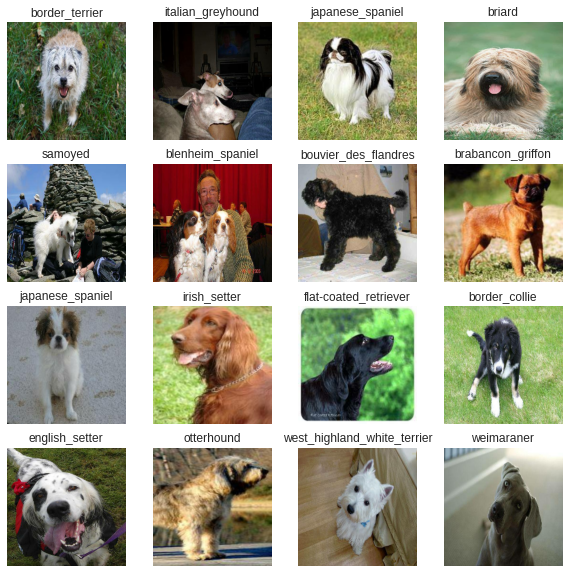

In [ ]:
# unbatch the data:
train_images, train_labels = next(train_data.as_numpy_iterator())

# figure
plt.figure(figsize=(10, 10))


for i in range(16):
    # plot
    ax = plt.subplot(4, 4, i+1)
    # Display an image
    plt.imshow(train_images[i])
    # Add the image label as the title
    plt.title(breeds[train_labels[i].argmax()])
    # Turn gird lines off
    plt.axis("off")

![separator](img/sep.jpeg)
## 2) Data modelling: 🌭

### 🐶 Choosing a model:
We set up the initial parameters of our model. here we will use two known models for dog related classifications: [Mobilenet v2](https://tfhub.dev/google/imagenet/mobilenet_v2_140_224/classification/4) from [Tensorflow Hub](https://tfhub.dev/s?dataset=imagenet-ilsvrc-2012-cls&module-type=image-classification) and [Xception](https://keras.io/api/applications/xception/) from [Keras API](https://keras.io/about/). For the moment, we focus on Mobilenet v2.

In [ ]:
# Setup input shape
INPUT_SHAPE = [None, 224, 224, 3] # batch, height, width, colour channels

# Setup output shape
OUTPUT_SHAPE = len(breeds) # number of unique labels

#pre trained model from tensorflow_hub:
MODEL_URL = 'https://tfhub.dev/google/imagenet/mobilenet_v2_140_224/classification/4'

We create a function that will build a `keras` model from our inputs:

In [ ]:
def build_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
    '''
    Creates and builds and returns a keras model from input shape, output shape and url
    '''
    print("Building model with:", model_url.split('/')[5])

  ## Setup the layers

    model = Sequential([
    hub.KerasLayer(model_url), # input layer
    Dense(output_shape, activation="softmax")]) # output layer

  # Compile the model
    opt = Adam(lr=0.001) # Gradient descent ptimizer
    model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

    
  # Build the model
    model.build(input_shape) # Let the model know what kind of inputs it'll be getting
  
    return model

and we create our model: here we will choose a pre trained model from `tensorflow_hub`: here I will only use Mobilenet_v2_140_224 in order to have an idea of what we're doing.

In [ ]:
# Create a model and check its details
model_1000 = build_model(INPUT_SHAPE, OUTPUT_SHAPE, MODEL_URL)
model_1000.summary()

Building model with: mobilenet_v2_140_224
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1001)              6158505   
_________________________________________________________________
dense (Dense)                (None, 120)               120240    
Total params: 6,278,745
Trainable params: 120,240
Non-trainable params: 6,158,505
_________________________________________________________________


### 🐶 Setting callbacks:

#### 🐾 Checkpoint callback:

We set a checkpoint callback:

In [ ]:
checkpoint = tf.keras.callbacks.ModelCheckpoint("/content/drive/MyDrive/ML/dog_breed/models", 
                                                monitor='val_accuracy', verbose=1, 
                                                save_best_only=True, mode='max')

#### 🐾 TensorBoard callback: 
   
   We use the TensorBoard functions from TensorFlow's `magics` in order to visualize the progress and training of our model. 

We load the TensorBoard notebook extension:

In [ ]:
%load_ext tensorboard

We create a log folder:

In [ ]:
import datetime, os

logs_base_dir = "/content/drive/MyDrive/ML/dog_breed/logs"
os.makedirs(logs_base_dir, exist_ok=True)

and create a function that we call every time we want a TensorBoard callback:

In [ ]:
def create_tensorboard_callback():
    # Create a log directory for storing TensorBoard logs
    logdir = os.path.join("/content/drive/MyDrive/ML/dog_breed/logs",
                          datetime.datetime.now().strftime('%d-%m-%Y - %H:%M:%S')
                          )
    return tf.keras.callbacks.TensorBoard(logdir)

   #### 🐾 Early stopping  callback: 
   
   We use kera's [Early stopping](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping) to stop our model when a certain evaluation metric stops improving in order to avoid overfitting. Here, we use the accuracy metric and make our model stop after 3 rounds of no improvement:

In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3)

### 🐶 Training a model:

#### 🐾 Subset training: 

We will train our model on a subset of the data to make sure everything works.

We set up the number of epochs (i.e. how many rounds will the model look through the data)

In [ ]:
NUM_EPOCHS = 100

And build a function to train our model:

In [ ]:
def train_model(model, train_data, val_data, NUM_EPOCHS):
    '''
    Trains a given model and returns the trained version.
    '''
    # Create a TensorBoard session
    tensorboard = create_tensorboard_callback()

    # Fit the model to the data passing it the callbacks we created
    model.fit( x = train_data,
              epochs = NUM_EPOCHS,
              validation_data = val_data,
              validation_freq = 1, 
              callbacks = [tensorboard, early_stopping])

    return model

And finallt, we fit our model:

In [ ]:
model_1000 = train_model(model_1000, train_data, val_data, NUM_EPOCHS)

Epoch 1/100
25/25 [==============================] - 464s 17s/step - loss: 5.3168 - accuracy: 0.0450 - val_loss: 3.3602 - val_accuracy: 0.2600
Epoch 2/100
25/25 [==============================] - 6s 223ms/step - loss: 2.0265 - accuracy: 0.6095 - val_loss: 2.0665 - val_accuracy: 0.5350
Epoch 3/100
25/25 [==============================] - 6s 220ms/step - loss: 0.6751 - accuracy: 0.9285 - val_loss: 1.5746 - val_accuracy: 0.6600
Epoch 4/100
25/25 [==============================] - 6s 219ms/step - loss: 0.2601 - accuracy: 0.9932 - val_loss: 1.3863 - val_accuracy: 0.6700
Epoch 5/100
25/25 [==============================] - 5s 216ms/step - loss: 0.1454 - accuracy: 1.0000 - val_loss: 1.3112 - val_accuracy: 0.6600
Epoch 6/100
25/25 [==============================] - 5s 216ms/step - loss: 0.0994 - accuracy: 1.0000 - val_loss: 1.2678 - val_accuracy: 0.6800
Epoch 7/100
25/25 [==============================] - 5s 216ms/step - loss: 0.0757 - accuracy: 1.0000 - val_loss: 1.2328 - val_accuracy: 0.6750

All good then, our model is learning! We can now check the TensorBoard logs:

In [ ]:
%tensorboard --logdir {logs_base_dir}

<IPython.core.display.Javascript object>

#### 🐾 Making predictions:

Now we evaluate our model on the training test set by making prediction on the validation set (here: around 200 images)

In [ ]:
# make predictions:
predictions_1000 = model_1000.predict(val_data, verbose=1)

7/7 [==============================] - 2s 166ms/step


We need to get the following informations out of our predictions:
   * Prediction labels:

In [ ]:
def get_pred_label(predictions):
  '''
  Turns an array of prediction probabilities into a label.
  '''
  return breeds[np.argmax(predictions)]

# test:
#pred_label = get_pred_label(predictions_1000[np.random.randint(0,200)])
#pred_label

   * Validation labels (truth labels) and Validation images:

In [ ]:
def unBatch(data):
    '''
    Takes a batched dataset of (image, label) Tensors and returns separate arrays
    of images and labels.
    '''
    images = []
    labels = []
    
    for image, label in data.unbatch().as_numpy_iterator():
        images.append(image)
        labels.append(breeds[np.argmax(label)])
    
    return images, labels

# test:
#val_images, val_labels = unBatch(val_data)
#val_images[np.random.randint(0,200)].shape, val_labels[np.random.randint(0,200)]

#### 🐾 Visualize predictions:

We clearly observe that our model is overfitting: It reached 100% of accurace on the training data way too early, with less than 70% of accuracy on the validation data. We will plot the pictures with the predicted label, the true label and its predicted probability.

In [ ]:
def plot_pred(predictions, labels, images, i):
    '''
    View the prediction, ground truth label and image for sample i.
    '''   
    pred, label_true, image = predictions[i], labels[i], images[i]

    # Get the predicted label
    label_pred = get_pred_label(pred)
    # Find the top 10 prediction confidence indexes
    top_10_pred_indexes = pred.argsort()[-10:][::-1]
    # Find the top 10 prediction confidence values
    top_10_pred_values = pred[top_10_pred_indexes]
    # Find the top 10 prediction labels
    top_10_pred_labels = breeds[top_10_pred_indexes]

    # Plot image
    fig, ax = plt.subplots(figsize = (6,6))
    
    # Setup plot
    top_plot = plt.barh(np.arange(len(top_10_pred_labels)), 
                     top_10_pred_values, 
                     color=colours[1])

    plt.yticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels)
    plt.imshow(image, extent=[-0.05, 1.0, -1.0, 10.0])
    plt.axis('tight')

    # Change color of true label
    if np.isin(label_true, top_10_pred_labels):
        top_plot[np.argmax(top_10_pred_labels == label_true)].set_color(colours[3])
    else:
        pass

    # Change the color of the title depending on if the prediction is right or wrong
    if label_pred == label_true: 
        color = "blue"
    else:
        color = "red"
    
    # Show predicted probability 
    plt.title('{} {:2.0f}% ({})'.format(label_pred,
                                      np.max(pred)*100,
                                      label_true),
                                      color=color)

To see how this works, we can try on several random values:

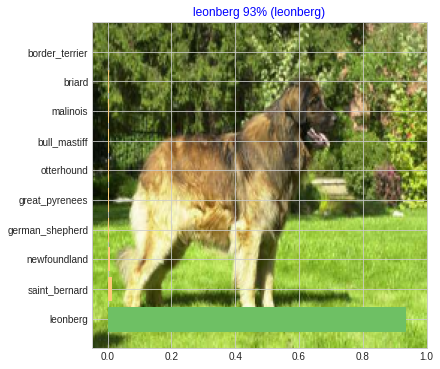

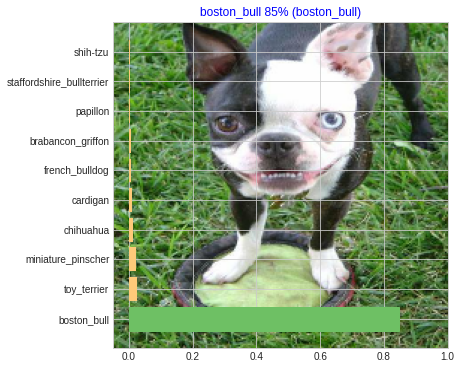

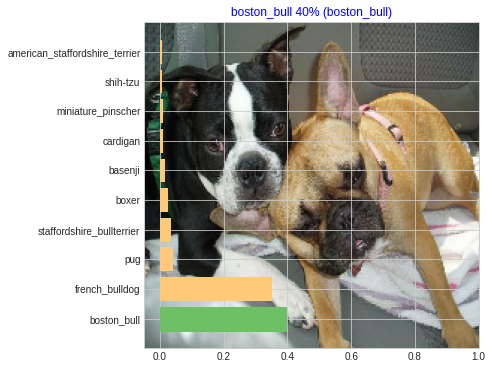

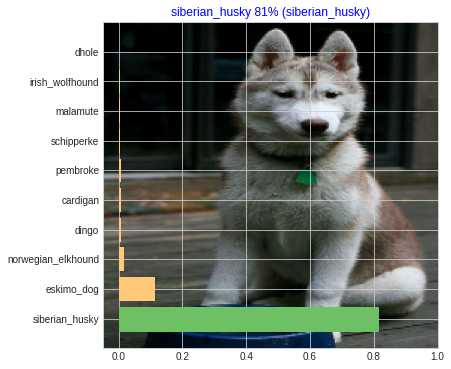

In [ ]:
for i in range(4) :
    plot_pred(predictions_1000, 
              val_labels,
              val_images,
              np.random.randint(0,200))

#### 🐾 full data training: 

I have trained our model on the full Data on a GPU for faster performances. For convenience, we load our model trained on the full data set:

In [ ]:
# set random seed
np.random.seed(1729)

# create validation set for the subset_data:
Xf_train, Xf_val, yf_train, yf_val = train_test_split(X, y, test_size = 0.2)

# Batch the train and validation data
train_data_full = Batch(Xf_train, yf_train)
val_data_full = Batch(Xf_val, yf_val, valid_data=True)

# Load trained model
model_full = load_model('/content/drive/MyDrive/ML/dog_breed/models/15-03-2021 - 17:18:01-mobilenet_v2_no-augdata.h5')

# Create a model
#model_full = build_model(INPUT_SHAPE, OUTPUT_SHAPE, MODEL_URL)

# Train the model on the full dataset
#history = model_full.fit(x = train_data_full,
#                         epochs = NUM_EPOCHS,
#                         validation_data = val_data_full,
#                         validation_freq = 1,
#                         callbacks = [early_stopping])          

Creating training data batches...
Done!
Creating validation data batches...
Done!
Loading saved model from: /content/drive/MyDrive/ML/dog_breed/models/15-03-2021 - 17:18:01-mobilenet_v2_no-augdata.h5


We evaluate the `accuracy` and `loss` of our model:

In [ ]:
model_full_eval = model_full.evaluate(val_data_full)

64/64 [==============================] - 793s 12s/step - loss: 0.6375 - accuracy: 0.8152


In [ ]:
print('Accuracy: {:.2f}%\nLoss: {:.2f}'.format(model_full_eval[1] * 100, model_full_eval[0]))

Accuracy: 81.52%
Loss: 0.64


and observe that we have a score of 81,52% accuracy and 0.64 of loss.

We make our predictions:

In [ ]:
predictions_full = model_full.predict(val_data_full, verbose=1)

64/64 [==============================] - 9s 133ms/step


And we plot some predictions: 

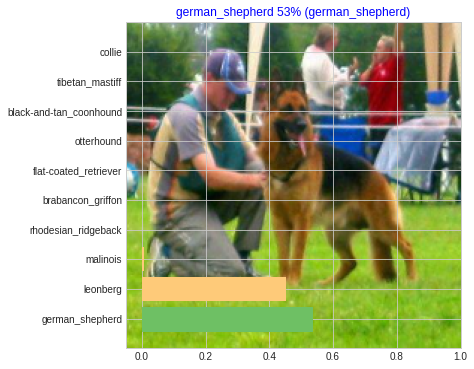

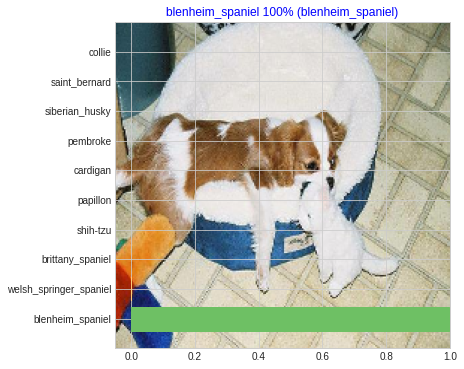

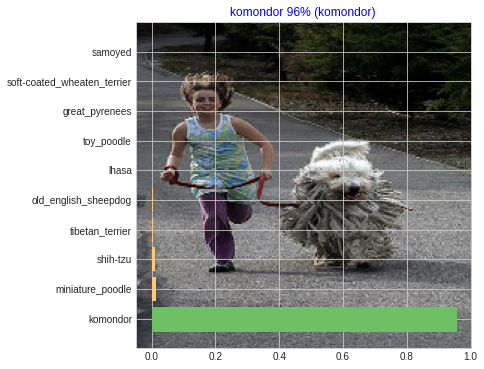

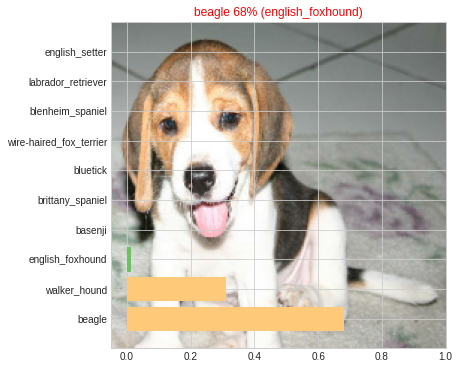

In [ ]:
# Get prediction labels:
pred_labels_full = [ get_pred_label(predictions_full[i]) for i in range(len(predictions_full))]

# unbatch validation data:
val_images_full, val_labels_full = unBatch(val_data_full)

# plot predictions:
for i in range(4) :
    plot_pred(predictions_full, 
              val_labels_full,
              val_images_full,
              np.random.randint(0,200))

### 🐶 Model evaluation:

We evaluate our model and see how it is doing so far: 

We start by plotting a detailed classification report:

In [ ]:
report = classification_report(np.argmax(predictions_full,axis=1), np.argmax(yf_val, axis=1), target_names=breeds, output_dict=True)

report_df = pd.DataFrame(report).T
report_df

,precision,recall,f1-score,support
affenpinscher,0.777778,0.875000,0.823529,16.000000
afghan_hound,0.931034,0.964286,0.947368,28.000000
african_hunting_dog,1.000000,1.000000,1.000000,16.000000
airedale,0.964286,0.900000,0.931034,30.000000
american_staffordshire_terrier,0.692308,0.450000,0.545455,20.000000
...,...,...,...,...
wire-haired_fox_terrier,0.857143,0.600000,0.705882,20.000000
yorkshire_terrier,0.750000,0.631579,0.685714,19.000000
accuracy,0.815159,0.815159,0.815159,0.815159
macro avg,0.804588,0.810483,0.800445,2045.000000


We can see the breeds that our model is confident in guessing:

In [ ]:
report_df['precision'].sort_values(ascending = False)[:10]

japanese_spaniel               1.0
soft-coated_wheaten_terrier    1.0
african_hunting_dog            1.0
curly-coated_retriever         1.0
papillon                       1.0
west_highland_white_terrier    1.0
clumber                        1.0
chow                           1.0
saint_bernard                  1.0
cardigan                       1.0
Name: precision, dtype: float64

And the ones he's not:

In [ ]:
report_df['precision'].sort_values(ascending = True)[:10]

eskimo_dog                   0.181818
miniature_poodle             0.357143
walker_hound                 0.400000
border_collie                0.400000
boxer                        0.466667
staffordshire_bullterrier    0.466667
chihuahua                    0.523810
lakeland_terrier             0.555556
flat-coated_retriever        0.588235
malamute                     0.600000
Name: precision, dtype: float64

We can also have a preview (up to the first 20 breeds) of the confusion matrix:

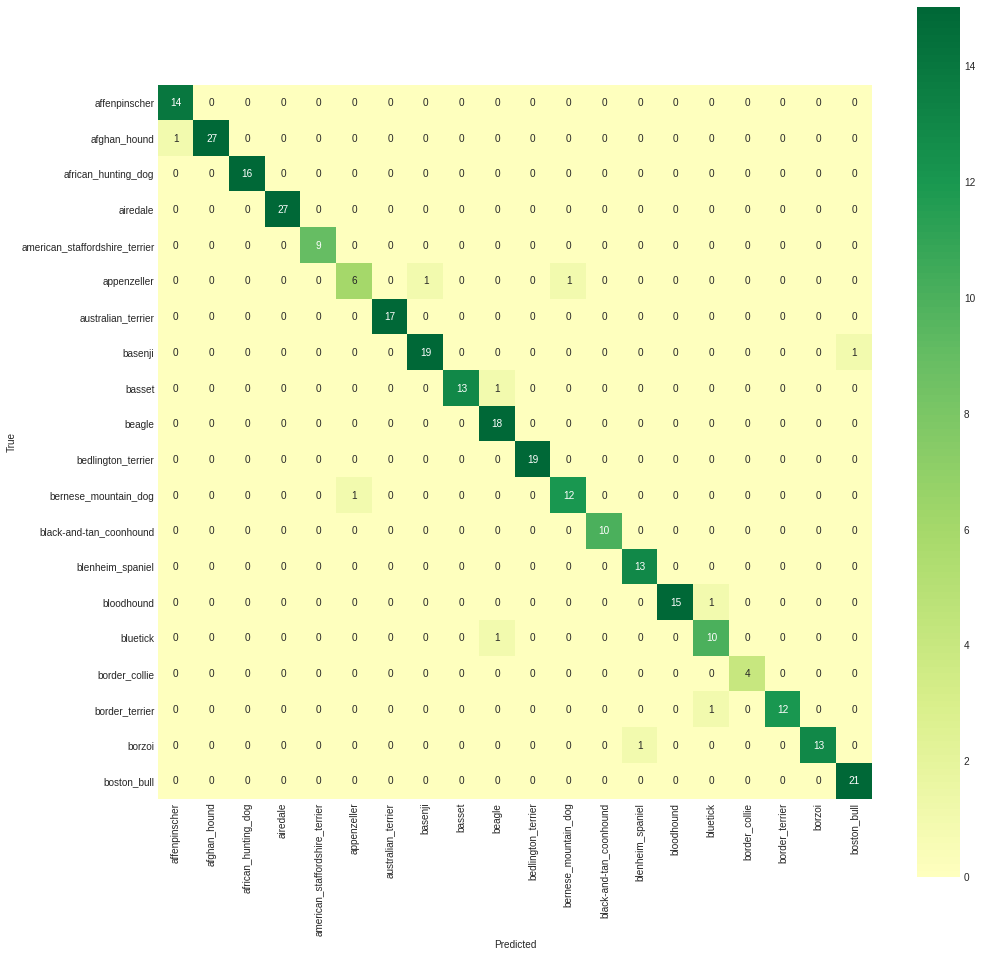

In [ ]:
conf_mtrx = confusion_matrix(np.argmax(predictions_full,axis=1), np.argmax(yf_val, axis=1))

conf_mtrx_plot(conf_mtrx, 20);

We can observe the performance of our model through the accuracy curve, one clearly sees a very noticeable gap between the training and test gap. this actually shows that our model is overfitting.

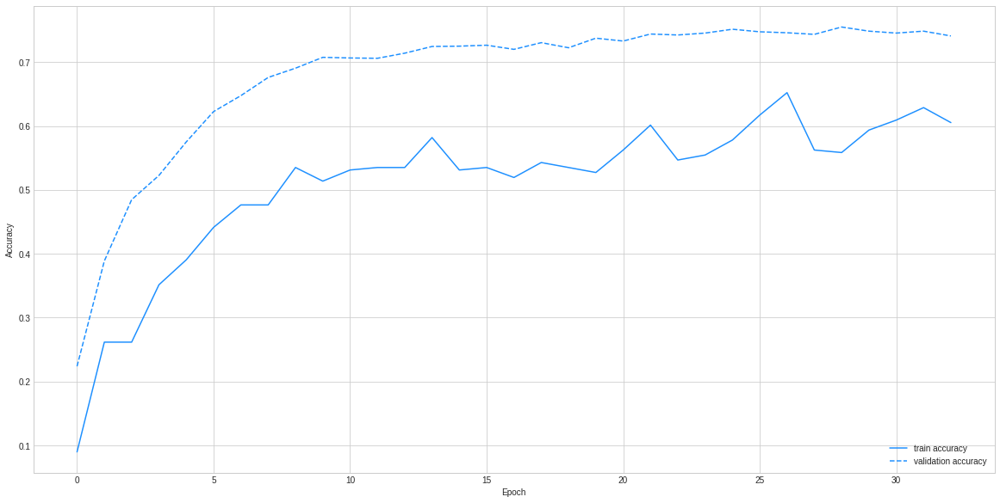

In [ ]:
fig, ax = plt.subplots(figsize = (20,10))

plt.plot(cstm_xception_hist.history['accuracy'],
         label='train accuracy',
         c='dodgerblue', ls='-')
plt.plot(cstm_xception_hist.history['val_accuracy'],
         label='validation accuracy',
         c='dodgerblue', ls='--')

plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.show()

In order to try to correct that and avoid overfitting patterns, we will use *data auguementation* and *dropouts* :

![separator](img/sep.jpeg)
## 3) Improving our model: 🌭

### 🐶 Using data augementation:

As we saw with barely 1000 examples, and confirmed after full training, our model was clearly overfitting. One way to avoid that is using [Data augmentation](https://bair.berkeley.edu/blog/2019/06/07/data_aug/): we take the training images and manipulate (crop, resize) or distort them (flip, rotate) to create more generalized patterns for the model to learn from. 

**NOTE:** Data augmentation is an *augementation* in the sense where it increases the generalizability of the model, and NOT an actual addition or increase in the dataset, i.e. it does not increase the size of the dataset per se.

In [ ]:
# Training ImagaDataGenerator with Augmentation transf. 
datagen = ImageDataGenerator(rescale=1./255,
                             validation_split=0.2,
                             rotation_range=45, # randomly rotate pictures
                             width_shift_range=0.2, # randomly translate pictures vertically 
                             height_shift_range=0.2, # randomly translate pictures horizontally
                             shear_range=0.2, # randomly applying shearing transformations.
                             zoom_range=0.25, # randomly zoom inside pictures.
                             horizontal_flip=True, # randomly flip half the images horizontally
                             fill_mode='nearest')

and we preprocess our data for Data augementation:

In [ ]:
# prepare the dataframe
train_df['id'] = train_df["id"].apply(lambda x : x+".jpg")

In [ ]:
# Create a flow from dataframe for training data
train_gen = datagen.flow_from_dataframe(dataframe=train_df,
                                              directory="/content/drive/MyDrive/ML/dog_breed/files/train",
                                              x_col="id",
                                              y_col="breed",
                                              subset="training",
                                              shuffle=True,
                                              seed=1729, 
                                              target_size=(IMG_SIZE, IMG_SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical")

# Create a flow from dataframe for validation data
valid_gen = datagen.flow_from_dataframe(dataframe=train_df,
                                              directory="/content/drive/MyDrive/ML/dog_breed/files/train",
                                              x_col="id",
                                              y_col="breed",
                                              subset="validation",
                                              target_size=(IMG_SIZE, IMG_SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical")

Found 8178 validated image filenames belonging to 120 classes.
Found 2044 validated image filenames belonging to 120 classes.


In [ ]:
#@title

# Create a flow from the directory for training data
train_gen = train_datagen.flow_from_directory('/content/drive/MyDrive/ML/dog_breed/class_files', 
                                              subset='training',
                                              shuffle=True, 
                                              seed=1729, 
                                              target_size=(IMG_SIZE, IMG_SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical")

# Create a flow from the directory for validation data
valid_gen = valid_datagen.flow_from_directory("/content/drive/MyDrive/ML/dog_breed/class_files",
                                              subset='validation',
                                              seed=1729, 
                                              target_size=(IMG_SIZE, IMG_SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical")



### 🐶 using Dropouts:

Dropouts is another technique that helps preventing over fitting, when used in 

In [ ]:
# set random seed
np.random.seed(1729)

# Load trained model
#model_full = load_model('/content/drive/MyDrive/ML/dog_breed/models/13-03-2021 - 19:14:00-Mobilenet v2 140 - Adam.h5')

# Create the model
model_full_aug = Sequential([
hub.KerasLayer(MODEL_URL), # input layer
Dense(256, activation='relu'),
Dropout(0.5),
Dense(OUTPUT_SHAPE, activation="softmax")]) # output layer

# Compile the model
opt = Adam(lr=0.001) # Gradient descent ptimizer
model_full_aug.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

# Build the model
model_full_aug.build(INPUT_SHAPE)

model_full_aug.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1001)              6158505   
_________________________________________________________________
dense (Dense)                (None, 256)               256512    
_________________________________________________________________
dropout (Dropout)            (None, 256)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 120)               30840     
Total params: 6,445,857
Trainable params: 287,352
Non-trainable params: 6,158,505
_________________________________________________________________


### 🐶 K-fold cross validation:

We evaluate our model using K-fold cross validation. Here is a nice pipeline for that:

In [ ]:
VALIDATION_ACCURACY = []
VALIDATION_LOSS = []

fold = 1
kf = KFold(n_splits = 5, shuffle = True, random_state = 1729)

# Set up manual K-fold cross validation:
for train_index, test_index in kf.split(train_df):
  trainData = train_df.iloc[train_index]
  testData = train_df.iloc[test_index]
  print('Initializing Kfold %s'%str(fold))
  print('Train shape:',trainData.shape)
  print('Test shape:',testData.shape)
  epochs = 100

  # prepare training and validation generators
  train_datagen = ImageDataGenerator(rescale=1./255,
                                  validation_split=0.2,
                                  rotation_range=45, # randomly rotate pictures
                                  width_shift_range=0.2, # randomly translate pictures vertically 
                                  height_shift_range=0.2, # randomly translate pictures horizontally
                                  shear_range=0.2, # randomly applying shearing transformations.
                                  zoom_range=0.25, # randomly zoom inside pictures.
                                  horizontal_flip=True, # randomly flip half the images horizontally
                                  fill_mode='nearest')
  valid_datagen = ImageDataGenerator(rescale=1. / 255) 

  # Create a flow from dataframe for training data
  train_gen = train_datagen.flow_from_dataframe(dataframe=trainData,
                                                directory="/content/drive/MyDrive/ML/dog_breed/files/train",
                                                x_col="id",
                                                y_col="breed",
                                                subset="training",
                                                shuffle=True,
                                                seed=1729, 
                                                target_size=(IMG_SIZE, IMG_SIZE),
                                                batch_size=BATCH_SIZE,
                                                class_mode="categorical")
  valid_gen = train_datagen.flow_from_dataframe(dataframe=trainData,
                                                directory="/content/drive/MyDrive/ML/dog_breed/files/train",
                                                x_col="id",
                                                y_col="breed",
                                                subset="validation",
                                                target_size=(IMG_SIZE, IMG_SIZE),
                                                batch_size=BATCH_SIZE,
                                                class_mode="categorical")

  # Create the model
  model_full_aug = Sequential([
  hub.KerasLayer(MODEL_URL), # input layer
  Dense(256, activation='relu'),
  Dropout(0.5),
  Dense(OUTPUT_SHAPE, activation="softmax")]) # output layer

  # Compile the model
  opt = Adam(lr=0.001) # Gradient descent ptimizer
  model_full_aug.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

  # Build the model
  model_full_aug.build(INPUT_SHAPE)

  # Setting callbacks
  early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy", patience=8)
  checkpoint = tf.keras.callbacks.ModelCheckpoint("/content/drive/MyDrive/ML/dog_breed/models/"+get_model_name(fold), 
                                                  monitor='val_accuracy', 
                                                  verbose=1, 
                                                  save_best_only=True, 
                                                  mode='max')

  # Train the model 
  history_aug = model_full_aug.fit(x = train_gen,
                                  steps_per_epoch = train_gen.n // train_gen.batch_size,
                                  epochs = NUM_EPOCHS,
                                  validation_data = valid_gen,
                                  validation_steps = valid_gen.n // valid_gen.batch_size,
                                  callbacks = [early_stopping, checkpoint])        

  # LOAD BEST MODEL to evaluate the performance of the model
  model_full_aug.load_weights("/content/drive/MyDrive/ML/dog_breed/models/model_"+str(fold)+"fold.h5")
  results = model_full_aug.evaluate(valid_gen)
  results = dict(zip(model_full_aug.metrics_names,results))

  VALIDATION_ACCURACY.append(results['accuracy'])
  VALIDATION_LOSS.append(results['loss'])

  tf.keras.backend.clear_session()

  fold += 1

Initializing Kfold 1
Train shape: (8177, 2)
Test shape: (2045, 2)
Found 6542 validated image filenames belonging to 120 classes.
Found 1635 validated image filenames belonging to 120 classes.
Epoch 1/100
204/204 [==============================] - 116s 552ms/step - loss: 4.0491 - accuracy: 0.1738 - val_loss: 1.5355 - val_accuracy: 0.5778

Epoch 00001: val_accuracy improved from -inf to 0.57782, saving model to /content/drive/MyDrive/ML/dog_breed/models/model_1fold.h5
Epoch 2/100
204/204 [==============================] - 112s 551ms/step - loss: 1.7872 - accuracy: 0.5197 - val_loss: 1.3385 - val_accuracy: 0.6305

Epoch 00002: val_accuracy improved from 0.57782 to 0.63051, saving model to /content/drive/MyDrive/ML/dog_breed/models/model_1fold.h5
Epoch 3/100
204/204 [==============================] - 112s 549ms/step - loss: 1.5198 - accuracy: 0.5839 - val_loss: 1.2037 - val_accuracy: 0.6452

Epoch 00003: val_accuracy improved from 0.63051 to 0.64522, saving model to /content/drive/MyDrive/

We can have a look on loss and accuracy of our model in CV 5 folds:

In [ ]:
#@title
#fold1_loss = np.array([4.0491, 1.7872, 1.5198, 1.371, 1.2649, 1.1587, 1.1672, 1.0771, 1.0738, 1.0051, 0.9765, 0.9877, 0.9781, 0.9507, 0.9152])
#fold1_acc = np.array([0.1738, 0.5197, 0.5839, 0.6216, 0.6494, 0.657, 0.6546, 0.6835, 0.6902, 0.6965, 0.7095, 0.7092, 0.7112, 0.7103, 0.733])
#fold1_val_acc = np.array([0.5778, 0.6305, 0.6452, 0.644, 0.6538, 0.655, 0.6691, 0.6569, 0.6385, 0.6679, 0.644, 0.6507, 0.6636, 0.6642, 0.6648])
#fold1_val_loss = np.array([1.5355, 1.3385, 1.2037, 1.2621, 1.2089, 1.1988, 1.1808, 1.1822, 1.2232, 1.213, 1.242, 1.2407, 1.1925, 1.207, 1.2239])

##fold2_loss = np.array([4.0676, 1.7972, 1.5238, 1.3524, 1.254, 1.2111, 1.1461, 1.0965, 1.0711, 1.0125, 0.9639, 1.0018, 0.9667, 0.9799, 0.9688, 0.8976, 0.8737, 0.9087, 0.9216, 0.8901, 0.8329])
#fold2_acc = np.array([0.17, 0.5185, 0.5776, 0.6119, 0.6388, 0.6558, 0.6801, 0.684, 0.6847, 0.7022, 0.7057, 0.7075, 0.7152, 0.7213, 0.7045, 0.7324, 0.7301, 0.7251, 0.7272, 0.735, 0.7521])
#fold2_val_acc = np.array([0.5754, 0.6109, 0.6354, 0.6287, 0.6593, 0.6624, 0.6593, 0.6544, 0.6636, 0.6556, 0.6599, 0.6464, 0.671, 0.6532, 0.6581, 0.6593, 0.6409, 0.6691, 0.6489, 0.6556, 0.6654])
#fold2_val_loss = np.array([1.5471, 1.3498, 1.2614, 1.255, 1.1839, 1.1899, 1.1777, 1.214, 1.2028, 1.2261, 1.2572, 1.2591, 1.2046, 1.3128, 1.25, 1.3066, 1.2591, 1.2841, 1.3229, 1.3008, 1.2696])

#fold3_loss = np.array([4.1308, 1.7929, 1.4945, 1.3719, 1.2307, 1.1903, 1.1117, 1.1558, 1.0546, 1.057, 1.0042, 0.9907, 1.019, 0.9638, 0.9519, 0.8926, 0.8843, 0.8525, 0.8985, 0.8928])
#fold3_acc = np.array([0.1654, 0.5175, 0.5867, 0.6177, 0.6491, 0.6587, 0.6737, 0.6671, 0.6969, 0.6967, 0.7064, 0.7102, 0.7059, 0.7219, 0.7184, 0.7361, 0.7322, 0.7504, 0.7321, 0.7341])
#fold3_val_acc = np.array([0.5729, 0.6121, 0.6452, 0.6562, 0.6581, 0.6575, 0.6587, 0.6464, 0.6654, 0.6513, 0.6624, 0.6777, 0.6587, 0.6691, 0.6385, 0.6648, 0.6526, 0.6507, 0.6471, 0.6599])
#fold3_val_loss = np.array([1.5644, 1.3269, 1.2137, 1.2, 1.2101, 1.1698, 1.1626, 1.1937, 1.217, 1.2186, 1.1683, 1.2004, 1.2303, 1.2293, 1.2584, 1.2041, 1.2549, 1.2843, 1.2932, 1.3108])

#fold4_loss = np.array([4.1521, 1.8206, 1.5136, 1.3634, 1.2956, 1.1782, 1.1244, 1.0528, 1.0716, 1.0071, 1.0332, 0.9889, 0.9643, 0.9172, 0.914, 0.9384])
#fold4_acc = np.array([0.1612, 0.519, 0.5786, 0.6134, 0.6249, 0.6566, 0.6765, 0.7015, 0.6835, 0.7063, 0.699, 0.7091, 0.7086, 0.7265, 0.7248, 0.7226])
##fold4_val_acc = np.array([0.598, 0.6213, 0.6152, 0.6526, 0.671, 0.6538, 0.6612, 0.6728, 0.6544, 0.6605, 0.6685, 0.6587, 0.6489, 0.655, 0.6605, 0.6562])
#fold4_val_loss = np.array([1.5402, 1.3462, 1.2779, 1.2227, 1.1665, 1.2106, 1.1755, 1.1777, 1.2323, 1.2066, 1.2007, 1.1981, 1.2097, 1.2546, 1.2406, 1.2857])

#fold5_loss = np.array([4.0878, 1.7809, 1.5668, 1.3561, 1.3181, 1.1472, 1.129, 1.0911, 1.0517, 1.0442, 0.9922, 1.0125, 0.9526, 0.9997])
#fold5_acc = np.array([0.1694, 0.527, 0.568, 0.6164, 0.6302, 0.673, 0.6797, 0.6825, 0.6912, 0.6928, 0.7106, 0.7083, 0.7196, 0.7084])
#fold5_val_acc = np.array([0.5729, 0.6391, 0.6207, 0.6477, 0.6354, 0.6771, 0.6501, 0.6593, 0.6373, 0.6513, 0.6397, 0.6452, 0.6526, 0.6354])
#fold5_val_loss = np.array([1.5687, 1.3066, 1.3077, 1.2503, 1.2528, 1.186, 1.2187, 1.1953, 1.234, 1.2277, 1.2683, 1.2749, 1.2583, 1.2838])

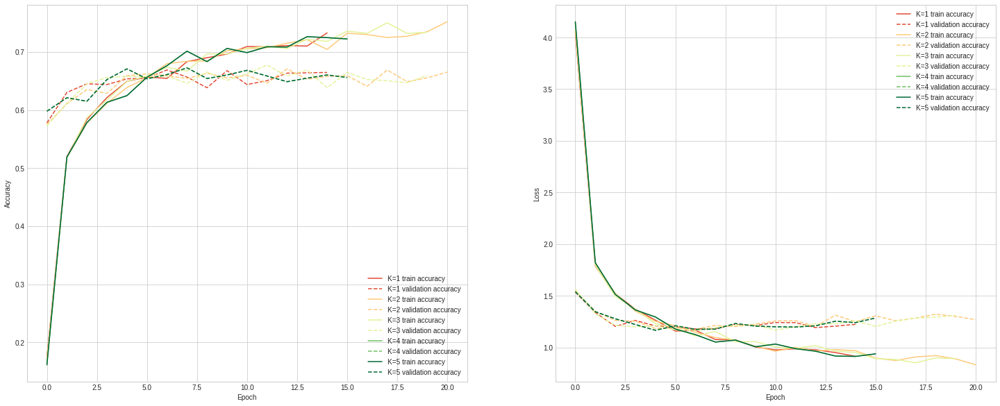

In [ ]:
#@title
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize = (25,10), sharex=True)

ax1.plot(fold1_acc,label='K=1 train accuracy',c=colours[0], ls='-')
ax1.plot(fold1_val_acc,label='K=1 validation accuracy',c=colours[0], ls='--')
ax1.plot(fold2_acc, label='K=2 train accuracy', c=colours[1], ls='-')
ax1.plot(fold2_val_acc, label='K=2 validation accuracy', c=colours[1], ls='--')
ax1.plot(fold3_acc, label='K=3 train accuracy', c=colours[2], ls='-')
ax1.plot(fold3_val_acc, label='K=3 validation accuracy', c=colours[2], ls='--')
ax1.plot(fold4_acc, label='K=4 train accuracy', c=colours[3], ls='-')
ax1.plot(fold4_val_acc, label='K=4 validation accuracy', c=colours[3], ls='--')
ax1.plot(fold4_acc, label='K=5 train accuracy', c=colours[4], ls='-')
ax1.plot(fold4_val_acc, label='K=5 validation accuracy', c=colours[4], ls='--')

ax2.plot(fold1_loss,label='K=1 train accuracy',c=colours[0], ls='-')
ax2.plot(fold1_val_loss,label='K=1 validation accuracy',c=colours[0], ls='--')
ax2.plot(fold2_loss, label='K=2 train accuracy', c=colours[1], ls='-')
ax2.plot(fold2_val_loss, label='K=2 validation accuracy', c=colours[1], ls='--')
ax2.plot(fold3_loss, label='K=3 train accuracy', c=colours[2], ls='-')
ax2.plot(fold3_val_loss, label='K=3 validation accuracy', c=colours[2], ls='--')
ax2.plot(fold4_loss, label='K=4 train accuracy', c=colours[3], ls='-')
ax2.plot(fold4_val_loss, label='K=4 validation accuracy', c=colours[3], ls='--')
ax2.plot(fold4_loss, label='K=5 train accuracy', c=colours[4], ls='-')
ax2.plot(fold4_val_loss, label='K=5 validation accuracy', c=colours[4], ls='--')

ax1.set_xlabel('Epoch')
ax1.set_ylabel('Accuracy')
ax2.set_xlabel('Epoch')
ax2.set_ylabel('Loss')
ax1.legend(loc='lower right')
ax2.legend(loc='upper right');

Here we actually did not have any significant improvement in accuracy (in fact it dropped to around 64%). However, the model is not overfitting as the gap is smaller between the validation and the training curves, which is still an improvement :

In [ ]:
#@title
#df_metrics = pd.DataFrame({'accuracy' : [fold1_acc.mean(), fold2_acc.mean(), fold3_acc.mean(), fold4_acc.mean(), fold5_acc.mean()], 
#                           'loss' : [fold1_loss.mean(), fold2_loss.mean(), fold3_loss.mean(), fold4_loss.mean(), fold5_loss.mean()]},
#                          index=("Fold 1", "Fold 2", "Fold 3", "Fold 4","Fold 5"))

df_metrics

,accuracy,loss
Fold 1,0.633560,1.352140
Fold 2,0.660938,1.225619
Fold 3,0.658860,1.247025
Fold 4,0.638256,1.333462
Fold 5,0.626936,1.394993


## 4) Exploring different models: 🌭

### 🐶 Features extraction:

At last, we will use feature extraction on known trained models on imageNet in order to boost our transfer learning process. This might give us a significant improvement of our classification. We will explore the following models:
* [Resnet50](https://arxiv.org/abs/1512.03385) 
* [Xception](https://arxiv.org/abs/1610.02357) from the amazing Francois Chollet.
* [Inception V3](https://arxiv.org/abs/1512.00567) of GoogleNet
* [Inception-Resnet](https://arxiv.org/abs/1602.07261)
* [NasNet](https://arxiv.org/abs/1707.07012) The very latest and buzzing NasNet

We first modify our function in order to quickly and efficiently preprocess our data: We chose the target size `(331, 331, 3)` because it's the one dictated by NasNetLarge if one loads it with `weights='imagnet'`


In [ ]:
TARGET_SIZE = (331,331,3)

def images_to_array(directory, dataframe, target_size = TARGET_SIZE):
    images = np.zeros([len(dataframe), target_size[0], target_size[1], target_size[2]], dtype=np.uint8)
    img = ''
    for ix, image_name in enumerate(dataframe['id'].values):
        img_dir = os.path.join(directory, image_name + '.jpg')
        img = load_img(img_dir, target_size = target_size)
        images[ix] = img_to_array(img)
    del img
    label_dict = dict(enumerate(dataframe['breed'].unique()))
    return images, label_dict

train_images, labels = images_to_array(train_dir, train_df[:])

We write a function that would run the convolutional base over our data, record its predictions so we can later feed them to a pretty simple CNN with a dense layer and some dropout: this is somehow less costly as we only need to run the convolutional base once for every image. However, we will not be able to use data augmentation here... as using it is by far way more costly (we would need to add Dense layers on top of the convolutional base , by using `DataImageGenerator`, and run it all on the input data)

In [ ]:
def get_features(model, preprocess_input, images, target_size = TARGET_SIZE):

    conv_base = model(input_shape = target_size, include_top=False, weights='imagenet', pooling = 'avg')

    cnn = Sequential([
    InputLayer(input_shape = target_size), # input layer
    Lambda(preprocess_input), # preprocessing layer
    conv_base ]) # base model

    features = cnn.predict(images)
    
    print('feature-map shape: {}'.format(features.shape))
    return features

#### 🐾 1. Resnet50:

In [ ]:
InceptionResNetV2(input_shape=TARGET_SIZE, include_top=False, weights='imagenet').summary()

Model: "inception_resnet_v2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 331, 331, 3) 0                                            
__________________________________________________________________________________________________
conv2d_203 (Conv2D)             (None, 165, 165, 32) 864         input_3[0][0]                    
__________________________________________________________________________________________________
batch_normalization_203 (BatchN (None, 165, 165, 32) 96          conv2d_203[0][0]                 
__________________________________________________________________________________________________
activation_203 (Activation)     (None, 165, 165, 32) 0           batch_normalization_203[0][0]    
________________________________________________________________________________

Features extraction:

In [ ]:
from keras.applications.inception_resnet_v2 import preprocess_input

resnet_preprocess = preprocess_input
resnet_features = get_features(InceptionResNetV2, resnet_preprocess, train_images)

219062272/219055592 [==============================] - 1s 0us/step
feature-map shape: (10222, 1536)


#### 🐾 2. Xception:

In [ ]:
Xception(input_shape=TARGET_SIZE, include_top=False, weights='imagenet').summary()

83689472/83683744 [==============================] - 1s 0us/step
Model: "xception"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 331, 331, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 165, 165, 32) 864         input_6[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 165, 165, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 165, 165, 32) 0           block1_conv1_bn[0][0]            
__________________________

Features extraction:

In [ ]:
from keras.applications.xception import preprocess_input

xception_preprocess = preprocess_input
xception_features = get_features(Xception, xception_preprocess, train_images)

83689472/83683744 [==============================] - 1s 0us/step
feature-map shape: (10222, 2048)


#### 🐾 3. Inception V3:

In [ ]:
InceptionV3(input_shape=TARGET_SIZE, include_top=False, weights='imagenet').summary()

87916544/87910968 [==============================] - 1s 0us/step
Model: "inception_v3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 331, 331, 3) 0                                            
__________________________________________________________________________________________________
conv2d_617 (Conv2D)             (None, 165, 165, 32) 864         input_9[0][0]                    
__________________________________________________________________________________________________
batch_normalization_617 (BatchN (None, 165, 165, 32) 96          conv2d_617[0][0]                 
__________________________________________________________________________________________________
activation_609 (Activation)     (None, 165, 165, 32) 0           batch_normalization_617[0][0]    
______________________

Features extraction:

In [ ]:
from keras.applications.inception_v3 import preprocess_input

inception_preprocess = preprocess_input
inception_features = get_features(InceptionV3, inception_preprocess, train_images)

87916544/87910968 [==============================] - 1s 0us/step
feature-map shape: (10222, 2048)


#### 🐾 4. NasNet:

In [ ]:
NASNetLarge(input_shape=TARGET_SIZE, include_top=False, weights='imagenet').summary()

343613440/343610240 [==============================] - 5s 0us/step
Model: "NASNet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_12 (InputLayer)           [(None, 331, 331, 3) 0                                            
__________________________________________________________________________________________________
stem_conv1 (Conv2D)             (None, 165, 165, 96) 2592        input_12[0][0]                   
__________________________________________________________________________________________________
stem_bn1 (BatchNormalization)   (None, 165, 165, 96) 384         stem_conv1[0][0]                 
__________________________________________________________________________________________________
activation_797 (Activation)     (None, 165, 165, 96) 0           stem_bn1[0][0]                   
__________________________

Features extraction:

In [ ]:
from keras.applications.nasnet import preprocess_input

nasnet_preprocessor = preprocess_input
nasnet_features = get_features(NASNetLarge, nasnet_preprocessor, train_images)

343613440/343610240 [==============================] - 4s 0us/step
feature-map shape: (10222, 4032)


Now, we stack up all our features and flatten it so we can feed it to our new CNN:

In [ ]:
final_features = np.concatenate([resnet_features, xception_features, inception_features, nasnet_features], axis = 1)

print('final features shape: {}'.format(final_features.shape))

final features shape: (10222, 9664)


### 🐶 Training 

At this point, we will 

In [ ]:
class_to_index = dict({labels[ix]:ix for ix in labels.keys()})
index_to_class = labels

In [ ]:
labels = train_df['breed'].map(class_to_index)

and define our densely connected classifier and train it on the data and labels that you just collected:

In [ ]:
FEATURES_SHAPE = final_features.shape[1]

cnn_model = Sequential([
InputLayer(input_shape = (FEATURES_SHAPE, )), # input layer
BatchNormalization(),
Dense(4096, activation = 'relu'),
Dropout(0.5),
Dense(1024, activation='relu'),
Dropout(0.7),
Dense(len(class_to_index), activation="softmax")]) # output layer

# Compile the model
opt = Adam(lr=0.001) # Gradient descent ptimizer
#opt = RMSprop(lr=0.001, rho=0.9)
cnn_model.compile(optimizer=opt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])


# Setting callbacks
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy", patience=20)
checkpoint = tf.keras.callbacks.ModelCheckpoint("/content/drive/MyDrive/ML/dog_breed/models/final_model", 
                                                monitor='val_accuracy', 
                                                verbose=1, 
                                                save_best_only=True, 
                                                mode='max')

cnn_model.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
batch_normalization_301 (Bat (None, 9664)              38656     
_________________________________________________________________
dense (Dense)                (None, 4096)              39587840  
_________________________________________________________________
dropout (Dropout)            (None, 4096)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 1024)              4195328   
_________________________________________________________________
dropout_1 (Dropout)          (None, 1024)              0         
_________________________________________________________________
dense_2 (Dense)              (None, 120)               123000    
Total params: 43,944,824
Trainable params: 43,925,496
Non-trainable params: 19,328
_____________________________________

and we commence training:

In [ ]:
# Train the model 
history1 = cnn_model.fit(final_features,
                    labels,
                    steps_per_epoch = len(final_features) // len(labels),
                    epochs = NUM_EPOCHS,
                    validation_split = 0.2,
                    callbacks = [early_stopping])  

Epoch 1/100
1/1 [==============================] - 2s 2s/step - loss: 7.6180 - accuracy: 0.0067 - val_loss: 3.8271 - val_accuracy: 0.8528
Epoch 2/100
1/1 [==============================] - 1s 804ms/step - loss: 1.0092 - accuracy: 0.7762 - val_loss: 3.3143 - val_accuracy: 0.9208
Epoch 3/100
1/1 [==============================] - 1s 846ms/step - loss: 0.4750 - accuracy: 0.8848 - val_loss: 2.8929 - val_accuracy: 0.9222
Epoch 4/100
1/1 [==============================] - 1s 806ms/step - loss: 0.3666 - accuracy: 0.9083 - val_loss: 2.5747 - val_accuracy: 0.9267
Epoch 5/100
1/1 [==============================] - 1s 827ms/step - loss: 0.3241 - accuracy: 0.9175 - val_loss: 2.3619 - val_accuracy: 0.9286
Epoch 6/100
1/1 [==============================] - 1s 797ms/step - loss: 0.3090 - accuracy: 0.9236 - val_loss: 2.2397 - val_accuracy: 0.9325
Epoch 7/100
1/1 [==============================] - 1s 839ms/step - loss: 0.2987 - accuracy: 0.9256 - val_loss: 2.1838 - val_accuracy: 0.9315
Epoch 8/100
1/1 

### 🐶 Evaluation

We can finally evaluate our model and see how it is doing, here we choose two gradient deccent optimizers: 
<span style='color:#e3f399'>Adam</span> and <span style='color:#006837'>RMSprop</span>

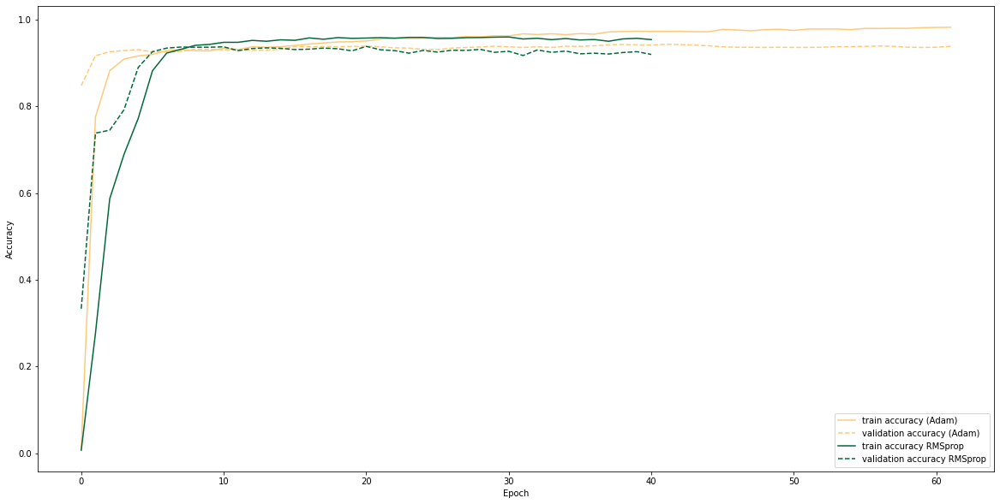

In [ ]:
fig, ax = plt.subplots(figsize = (20,10))

plt.plot(history1.history['accuracy'],
         label='train accuracy (Adam)',
         c=colours[1], ls='-')
plt.plot(history1.history['val_accuracy'],
         label='validation accuracy (Adam)',
         c=colours[1], ls='--')

plt.plot(history2.history['accuracy'],
         label='train accuracy RMSprop',
         c=colours[4], ls='-')
plt.plot(history2.history['val_accuracy'],
         label='validation accuracy RMSprop',
         c=colours[4], ls='--')

plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.show()

In [ ]:
# serialize model to JSON
model_json = cnn_model.to_json()
with open("model.json", "w") as json_file:
    json_file.write(model_json)

In [ ]:
# serialize weights to HDF5
cnn_model.save_weights("cnn_dogvision_weights.h5")
print("Saved model to disk")

Saved model to disk


In [ ]:
 # load json and create model
json_file = open('model.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
model_test = model_from_json(loaded_model_json)
# load weights into new model
model_test.load_weights("cnn_dogvision_weights.h5")
print("Loaded model from disk")

Loaded model from disk


![separator](img/sep.jpeg)
## 🦮 Conclusion 

We reached a pretty nice accuracy (>95%) so as a nice application, we would like to use our model to predict dog breeds from random images on the net. We will write some code to make that possible: 


In [ ]:
TARGET_SIZE = (331,331,3)
from PIL import Image
def dog_vision(model, source, local=False, target_size = TARGET_SIZE):
  img = ''
  if local:
    # Get image from directory
    image_paths = [source + fname for fname in os.listdir(source)]
    images = np.zeros([len(image_paths), target_size[0], target_size[1], target_size[2]], dtype=np.uint8)   
    for _, path in enumerate(image_paths):
      img = load_img(path, target_size = target_size)
      images[_] = img_to_array(img)
  else:
    images = np.zeros([1, target_size[0], target_size[1], target_size[2]], dtype=np.uint8)  
    req = request.urlopen(source).read()
    img = Image.open(BytesIO(req)).resize((target_size[0], target_size[1]))
    images[0] = img_to_array(img)
  del img

    # run feature extraction
  resnet_features = get_features(InceptionResNetV2, resnet_preprocess, images)
  xception_features = get_features(Xception, xception_preprocess, images)
  inception_features = get_features(InceptionV3, inception_preprocess, images)
  nasnet_features = get_features(NASNetLarge, nasnet_preprocessor, images)
  final_features = np.concatenate([resnet_features, xception_features, inception_features, nasnet_features], axis = 1)
  del resnet_features, xception_features, inception_features, nasnet_features
    
    # Make predictions
  predictions = model.predict(final_features)

  labels = dict(enumerate(train_df['breed'].unique()))
  
  # Check custom image predictions
  plt.figure(figsize=(10, 15))
  for i, image in enumerate(images):
    plt.subplot(4, 3, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.title(labels[np.argmax(predictions[i])])
    plt.imshow(image);

  tf.keras.backend.clear_session()

feature-map shape: (8, 1536)
feature-map shape: (8, 2048)
feature-map shape: (8, 2048)
feature-map shape: (8, 4032)


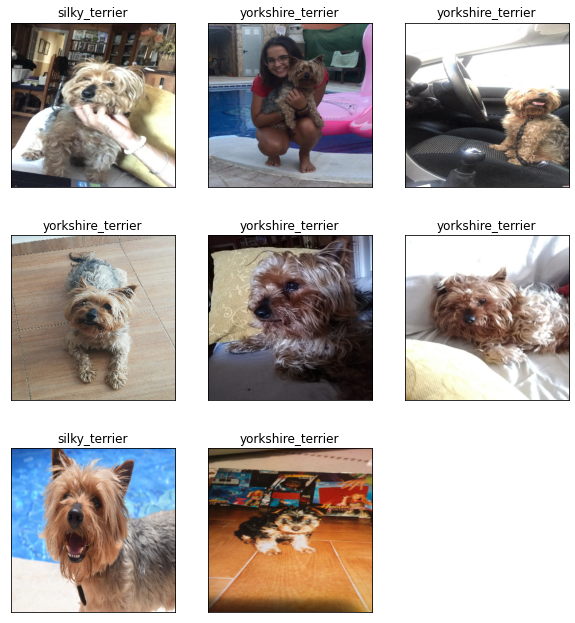

In [ ]:
local_dir = "/content/drive/MyDrive/ML/dog_breed/files/custom/"
URL = "https://images.theconversation.com/files/342682/original/file-20200618-41213-iu7wbs.jpg?ixlib=rb-1.1.0&rect=9%2C4%2C3268%2C2177&q=45&auto=format&w=926&fit=clip"
 
# load model
#cnn = load_model("/content/drive/MyDrive/ML/dog_breed/models/20-03-2021 - 21:27:07-final.h5")
cnn = model_test

dog_vision(cnn, local_dir, local=True)
#dog_vision(URL, local=False)